<a href="https://colab.research.google.com/github/joelwwiggins/supply_chain_simulation/blob/main/Model_Tuning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install pyod            # normal install
!pip install --upgrade pyod  # or update if needed
!pip install combo
!pip install sqlalchemy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 120 kB 14.1 MB/s 
     |████████████████████████████████| 38.1 MB 120.0 MB/s 
  Created wheel for pyod: filename=pyod-1.0.1-py3-none-any.whl size=147473 sha256=b01047e7ff4695c96ba302551a9e4dbdeb4e95cf33995b5a362ae73609220630
  Stored in directory: /root/.cache/pip/wheels/ea/c4/29/67ad87835b209f72e4706369c683741b09490f2829d64ea768
Successfully built pyod
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
      Successfully uninstalled scipy-1.4.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-whe

In [2]:
import numpy as np
import pandas as pd
from pyod.models.knn import KNN
from pyod.models.auto_encoder import AutoEncoder
from pyod.models.vae import VAE
from sqlalchemy import text
from pyod.utils.data import generate_data
import tensorflow as tf
import matplotlib.pyplot as plt
#from pyod.utils.data import evaluate_print
#from pyod.utils.example import visualize

# contamination = 0.1  # percentage of outliers
# n_train = 500  # number of training points
# n_test = 500  # number of testing points
# n_features = 25 # Number of features

# X_train, y_train, X_test, y_test = \
#     generate_data(n_train=n_train,
#                   n_test=n_test,
#                   n_features=n_features,
#                   contamination=contamination,
#                   random_state=42)


# X_train = pd.DataFrame(X_train)
# X_test = pd.DataFrame(X_test)

In [3]:

# df=pd.read_excel('/content/drive/MyDrive/opportune/Search Movements 3 Months 05102022.xlsx')
# demand=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=6)
# truck=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=7)
# rail=pd.read_excel('/content/drive/MyDrive/opportune/RA Tables - Inventory POC.xlsx',sheet_name=9)


In [4]:
# from pathlib import Path  
# filepath = Path('/content/drive/MyDrive/opportune/df_out.csv')  
# filepath.parent.mkdir(parents=True, exist_ok=True)
# filepath1 = Path('/content/drive/MyDrive/opportune/demand_out.csv')  
# filepath.parent.mkdir(parents=True, exist_ok=True)    
# df.to_csv(filepath)  
# demand.to_csv(filepath1)

In [5]:
df_csv=pd.read_csv('/content/drive/MyDrive/opportune/df_out.csv')
demand_csv=pd.read_csv('/content/drive/MyDrive/opportune/demand_out.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: DtypeWarning: Columns (9) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [6]:
df_csv['Movement Date']=pd.to_datetime(df_csv['Movement Date'])
demand_csv['From Date']=pd.to_datetime(demand_csv['From Date'])
df_csv.sort_values(by=['Movement Date'])

,Unnamed: 0,External Document Number,Line #,Status,Movement Date,Location,Moved Product,Type,Quantity,Gross Quantity,...,Carrier Business Associate,Lab Analysis,Lifting Number,Ancillary Number,Automatch Status,Load Measurement Type,Reason Code,Notes,Internal Document Number,Movement Document Date
14343,14343,6166401950,1,Matched,2022-02-01 00:00:00,MAMMOTH LAKES CA (COMMERCE)- AGP,Propane HD5,Delivery to Customer,9200.000,9200.000,...,(Empty),NaN,NaN,NaN,Automatch,(Empty),(Empty),NaN,449725.0,2022-02-01 00:00:00
2483,2483,6165847769,1,Matched,2022-02-01 00:00:00,PINEY FLATS TN - AGP,Propane HD5,Withdrawal from Storage,2010.436,2010.436,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435846.0,2022-02-01 00:00:00
2484,2484,6165847820,1,Matched,2022-02-01 00:00:00,JOHNSON CITY TN (SOUTH ROAN) - AGP,Propane HD5,Withdrawal from Storage,1512.517,1512.517,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435847.0,2022-02-01 00:00:00
2485,2485,6165847945,1,Matched,2022-02-01 00:00:00,KINGSPORT TN - AGP,Propane HD5,Withdrawal from Storage,2272.561,2272.561,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435848.0,2022-02-01 00:00:00
2486,2486,6165855624,1,Matched,2022-02-01 00:00:00,HOWELL MI - AGP,Propane HD5,Withdrawal from Storage,1275.502,1275.502,...,(Empty),NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,435849.0,2022-02-01 00:00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180621,180621,13036874,1,Unmatched,2022-05-10 15:03:00,EVANS CITY PA,Propane HD5,Truck,8700.000,8700.000,...,PTI,NaN,NaN,NaN,Automatch,(Empty),(Empty),SID:301095,639444.0,2022-05-09 00:00:00
180556,180556,1238420,1,Matched,2022-05-10 15:35:00,MILFORD VA,Propane HD5,Truck,9970.000,9970.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),SID:301791,639362.0,2022-05-09 00:00:00
180615,180615,55530064452,1,Matched,2022-05-10 15:41:00,ALBANY GA - DIXIE,Propane HD5,Truck,8599.000,8599.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),SID:302053,639434.0,2022-05-10 00:00:00
180617,180617,2011061,1,Matched,2022-05-10 17:02:00,SINKING SPRING PA - AGP,Propane HD5,Truck,9204.000,9249.000,...,PTI,NaN,NaN,NaN,Successfully Automatched,(Empty),(Empty),NaN,639437.0,2022-05-10 00:00:00


In [7]:
split_date ='2022-04-1'
start_date="2022-2-1"
df_csv_date = df_csv.loc[(df_csv['Movement Date'] <= split_date) & (df_csv['Movement Date']>=start_date)]
demand_csv_date = demand_csv.loc[(demand_csv['From Date'] <= split_date) & (demand_csv['From Date']>=start_date)]

In [8]:
print(df_csv_date.shape)
print(demand_csv_date.shape)

(129247, 41)
(92994, 19)


In [9]:
df_short=df_csv_date[['Movement Date','Type', 'Quantity','Tax Origin','Tax Destination']]
demand_short=demand_csv_date[['From Date','Order Quantity', 'Origin Location']]
# movement_demand=pd.merge(df_short,demand_short,how='outer',left_on='Movement Date',right_on='From Date')
demand_short.dtypes

From Date          datetime64[ns]
Order Quantity              int64
Origin Location            object
dtype: object

In [10]:
date_merge_all=pd.merge(df_short,demand_short,how='outer',left_on=['Movement Date','Tax Origin'],right_on=['From Date','Origin Location']).fillna(0)
date_merge_all_clean=date_merge_all.loc[(date_merge_all['Quantity'] >0) & (date_merge_all['Order Quantity'] > 0)]
date_merge=date_merge_all_clean[['Quantity','Type','Tax Origin','Tax Destination','Origin Location','Order Quantity']]

date_merge_dtype=date_merge[['Quantity','Order Quantity']].astype(int)
date_merge_obj=date_merge[['Type','Tax Origin','Tax Destination','Origin Location']]

In [11]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from tensorflow.keras import regularizers
from sklearn.preprocessing import OrdinalEncoder
from keras.callbacks import ModelCheckpoint, TensorBoard


le = preprocessing.LabelEncoder()
mm=preprocessing.MinMaxScaler()
ss=preprocessing.StandardScaler()
oe=preprocessing.OrdinalEncoder()

In [12]:
# date_merge_onehot=pd.get_dummies(date_merge)
# date_merge_onehot

In [13]:
# from sklearn.preprocessing import OneHotEncoder
# oh=OneHotEncoder()
# date_merge_scaled=oh.fit_transform(date_merge)
# pd.DataFrame.sparse.from_spmatrix(date_merge_scaled)

In [14]:
objList = date_merge.select_dtypes(include = "object").columns
print (objList)
intlist=date_merge.select_dtypes(include = ("int64")).columns
print (objList)
for feat in objList:
    date_merge[feat] = le.fit_transform(date_merge[feat].astype('str'))

print (date_merge.info())



Index(['Type', 'Tax Origin', 'Tax Destination', 'Origin Location'], dtype='object')
Index(['Type', 'Tax Origin', 'Tax Destination', 'Origin Location'], dtype='object')
<class 'pandas.core.frame.DataFrame'>
Int64Index: 90790 entries, 573 to 129697
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Quantity         90790 non-null  float64
 1   Type             90790 non-null  int64  
 2   Tax Origin       90790 non-null  int64  
 3   Tax Destination  90790 non-null  int64  
 4   Origin Location  90790 non-null  int64  
 5   Order Quantity   90790 non-null  float64
dtypes: float64(2), int64(4)
memory usage: 4.8 MB
None


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [15]:


date_merge_scaled=pd.DataFrame(mm.fit_transform(date_merge))
date_merge_scaled

,0,1,2,3,4,5
0,0.013590,1.0,0.309929,0.0,0.309929,0.038906
1,0.016668,1.0,0.309929,0.0,0.309929,0.038906
2,0.014488,1.0,0.309929,0.0,0.309929,0.038906
3,0.018796,1.0,0.309929,0.0,0.309929,0.038906
4,0.018338,1.0,0.309929,0.0,0.309929,0.038906
...,...,...,...,...,...,...
90785,0.019204,0.0,0.607801,0.0,0.607801,0.012392
90786,0.019750,1.0,0.757447,0.0,0.757447,0.008753
90787,0.019938,1.0,0.063830,0.0,0.063830,0.007752
90788,0.005872,1.0,0.063830,0.0,0.063830,0.007752


In [16]:
# date_merge_int_scaled=pd.DataFrame(date_merge_int).astype(int, errors='raise').fillna(0)
# date_merge_int_scaled_df=pd.DataFrame(date_merge_int_scaled)
# date_merge_str_df=pd.DataFrame(date_merge_str).astype(int, errors='raise').fillna(0)
# comb_scale=pd.concat([date_merge_str_df],axis=1)

In [17]:
X_train_scaled=date_merge_scaled.iloc[:80000,:].to_numpy()
X_test_scaled=date_merge_scaled.iloc[80001:,:].to_numpy()
X_test_scaled

array([[0.01537684, 1.        , 0.05673759, 0.        , 0.05673759,
        0.00814339],
       [0.00719114, 1.        , 0.05673759, 0.        , 0.05673759,
        0.00814339],
       [0.01135034, 1.        , 0.05673759, 0.        , 0.05673759,
        0.00814339],
       ...,
       [0.01993839, 1.        , 0.06382979, 0.        , 0.06382979,
        0.00775174],
       [0.00587176, 1.        , 0.06382979, 0.        , 0.06382979,
        0.00775174],
       [0.00450416, 1.        , 0.77943262, 0.        , 0.77943262,
        0.00357289]])

In [18]:

#When you do unsupervised learning, it is always a safe step to standardize the predictors
# from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import MinMaxScaler
# scaler = MinMaxScaler() 
# scaler.fit(X_train_opp)    # Only the training data are used to fit the scaler transformation,
# X_train_scaled = scaler.transform(X_train_opp) 
# X_test_scaled = scaler.transform(X_test_opp)  # then the scaler is used to transform the test input data.
# X_train_scaled = pd.DataFrame(X_train_scaled)
# X_test_scaled = pd.DataFrame(X_test_scaled)

In [19]:

X_train_con = X_train_scaled.reshape((X_train_scaled.shape[0], X_train_scaled.shape[1],1))
X_test_con = X_test_scaled.reshape((X_test_scaled.shape[0], X_test_scaled.shape[1],1))
X_test_con

array([[[0.01537684],
        [1.        ],
        [0.05673759],
        [0.        ],
        [0.05673759],
        [0.00814339]],

       [[0.00719114],
        [1.        ],
        [0.05673759],
        [0.        ],
        [0.05673759],
        [0.00814339]],

       [[0.01135034],
        [1.        ],
        [0.05673759],
        [0.        ],
        [0.05673759],
        [0.00814339]],

       ...,

       [[0.01993839],
        [1.        ],
        [0.06382979],
        [0.        ],
        [0.06382979],
        [0.00775174]],

       [[0.00587176],
        [1.        ],
        [0.06382979],
        [0.        ],
        [0.06382979],
        [0.00775174]],

       [[0.00450416],
        [1.        ],
        [0.77943262],
        [0.        ],
        [0.77943262],
        [0.00357289]]])

In [20]:

model_shape=X_train_con.shape
model_shape

(80000, 6, 1)

In [21]:
 %load_ext tensorboard
%tensorboard --logdir Graph

<IPython.core.display.Javascript object>

In [43]:
from sklearn.utils import shuffle

# Define the model - deep neural net, i.e., the number of input features and hidden nodes for each layer.
#  YOUR CODE GOES HERE
import tensorflow as tf
def cnn_model(X,Y):




    nn_model = tf.keras.models.Sequential()
    nn_model.build(input_shape=model_shape)
    # First hidden layer
    #  YOUR CODE GOES HERE
    nn_model.add(tf.keras.layers.Conv1D(4,3,activation="tanh",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(8,3,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(16,5,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.MaxPool1D(pool_size=2,data_format='channels_last',padding='same'))
    nn_model.add(tf.keras.layers.Conv1D(16,5,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.UpSampling1D(2))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(8,3,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.UpSampling1D(2))
    nn_model.add(tf.keras.layers.Dropout(0.1))
    nn_model.add(tf.keras.layers.Conv1D(4,3,activation="relu",padding='same'))
    nn_model.add(tf.keras.layers.UpSampling1D(2))
		# nn_model.add(tf.keras.layers.GlobalAveragePooling1D())

    nn_model.add(tf.keras.layers.Flatten())
    # nn_model.add(tf.keras.layers.Dense(12, activation='relu'))
    nn_model.add(tf.keras.layers.Dense(units=6,activation='linear'))
    nn_model.compile(loss='mse', optimizer='adam', metrics=['mse', 'mae'])
    es = tf.keras.callbacks.EarlyStopping(monitor='val_mae',patience=10)
    # checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath ="/content/sample_data")
    tbCallBack = tf.keras.callbacks.TensorBoard(log_dir='./Graph', histogram_freq=1, write_graph=True, write_images=True)
    cb_list = [es, tbCallBack]
    nn_model.fit(X, Y, epochs=300,validation_split=.1,shuffle=True,callbacks=cb_list)
    nn_model.evaluate(X, Y)
    return nn_model

m=cnn_model(X_train_con,X_train_con)
m.summary()
# nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# model.add(MaxPooling1D(pool_size=2, padding='valid'))


# Second hidden layer
#  YOUR CODE GOES HERE
# nn_model.add(tf.keras.layers.Dense(units=16, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# # nn_model.add(tf.keras.layers.Dense(units=16, activation="relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))

# # Output layer
# #  YOUR CODE GOES HERE
# nn_model.add(tf.keras.layers.Dense(units=2, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=16, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=32, activation="leaky_relu"))
# # nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# # nn_model.add(tf.keras.layers.Dense(units=140, activation="relu"))
# nn_model.add(tf.keras.layers.Dropout(rate=0.2))
# nn_model.add(tf.keras.layers.Dense(units=32, activation="softmax"))
# Check the structure of the model


Epoch 1/300
2250/2250 [==============================] - 12s 5ms/step - loss: 0.0120 - mse: 0.0120 - mae: 0.0538 - val_loss: 0.0053 - val_mse: 0.0053 - val_mae: 0.0428
Epoch 2/300
2250/2250 [==============================] - 10s 5ms/step - loss: 0.0018 - mse: 0.0018 - mae: 0.0232 - val_loss: 0.0050 - val_mse: 0.0050 - val_mae: 0.0407
Epoch 3/300
2250/2250 [==============================] - 10s 5ms/step - loss: 0.0013 - mse: 0.0013 - mae: 0.0191 - val_loss: 0.0072 - val_mse: 0.0072 - val_mae: 0.0477
Epoch 4/300
2250/2250 [==============================] - 10s 5ms/step - loss: 0.0010 - mse: 0.0010 - mae: 0.0167 - val_loss: 0.0069 - val_mse: 0.0069 - val_mae: 0.0463
Epoch 5/300
2250/2250 [==============================] - 10s 5ms/step - loss: 9.0916e-04 - mse: 9.0916e-04 - mae: 0.0154 - val_loss: 0.0076 - val_mse: 0.0076 - val_mae: 0.0481
Epoch 6/300
2250/2250 [==============================] - 10s 5ms/step - loss: 8.1161e-04 - mse: 8.1161e-04 - mae: 0.0144 - val_loss: 0.0082 - val_mse: 0

In [23]:
 %load_ext tensorboard
%tensorboard --logdir Graph

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 439), started 0:02:58 ago. (Use '!kill 439' to kill it.)

<IPython.core.display.Javascript object>

In [44]:
m.save("encode_decode_conv1d")

INFO:tensorflow:Assets written to: encode_decode_conv1d/assets


In [45]:
import matplotlib.pyplot as plt
reconstructions = m.predict(X_train_scaled)
train_loss = tf.keras.losses.mae(reconstructions, X_train_scaled)

import plotly.express as px
df_loss = pd.DataFrame(train_loss)
fig = px.histogram(df_loss, x=df_loss.iloc[:,0], nbins=50)
fig.show()

In [46]:

reconstructions_test = m.predict(X_test_scaled)
test_loss = tf.keras.losses.mae(reconstructions_test, X_test_scaled)


df_loss_test = pd.DataFrame(test_loss)
fig = px.histogram(df_loss_test, x=df_loss_test.iloc[:,0], nbins=50)
fig.update_layout(yaxis_type="log")
fig.show()

In [47]:


df_loss_test_df=pd.DataFrame(df_loss)
x_max=len(df_loss)
x_range=pd.DataFrame(range(0,x_max))
x_range['loss']=df_loss_test_df
x_range['x']=x_range.iloc[:,0]

In [48]:

reconstructions_test = m.predict(date_merge_scaled)
test_loss = tf.keras.losses.mae(reconstructions_test, date_merge_scaled)


In [49]:
threshold = np.mean(train_loss) + np.std(train_loss)*5
print("Threshold: ", threshold)

outlier_dates=pd.DataFrame(date_merge_all['Movement Date'])
outlier_table=outlier_dates['Movement Date']
loss_val=pd.DataFrame(test_loss)
loss_val.columns=['Loss']
loss_val_df=pd.DataFrame(loss_val)
outlier_table_df=pd.concat([loss_val_df,outlier_table],axis=1)

Threshold:  0.18218252656434702


In [50]:
loss_val

,Loss
0,0.031424
1,0.031950
2,0.031578
3,0.032314
4,0.032236
...,...
90785,0.059028
90786,0.070385
90787,0.009057
90788,0.009001


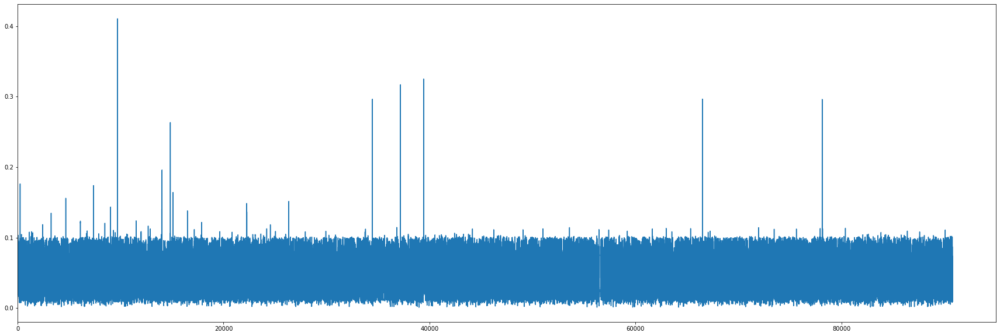

In [51]:
import matplotlib.pyplot as plt
import numpy as np


plt.figure(figsize=(30,10))
plt.xlim(0,95000)
plt.plot(loss_val)
plt.show()

In [52]:
#Choose a threshold value that is one standard deviations above the mean.


threshold = np.mean(train_loss) + np.std(train_loss)*5
print("Threshold: ", threshold)

outlier_dates=pd.DataFrame(date_merge_all['Movement Date'])
outlier_table['dates']=outlier_dates['Movement Date']
loss_val=pd.DataFrame(test_loss)
loss_val.columns=['Loss']
loss_val_df=pd.DataFrame(loss_val)
outlier_table_df=pd.concat([loss_val_df,outlier_table],axis=1)


Threshold:  0.18218252656434702


In [53]:

outlier_table_df.loc[outlier_table_df['Loss'] >= threshold].sort_values(by=['Movement Date'])



,Loss,Movement Date
9702,0.410715,2022-02-05 00:00:00
14027,0.196038,2022-02-07 00:00:00
14829,0.263467,2022-02-07 00:00:00
34453,0.296458,2022-02-15 00:00:00
37176,0.317093,2022-02-15 00:00:00
39429,0.325189,2022-02-16 00:00:00
39431,0.277746,2022-02-17 00:00:00
66503,0.296637,2022-03-01 00:00:00
78126,0.296227,2022-03-07 00:00:00


In [34]:
list(date_merge.columns)

['Quantity',
 'Type',
 'Tax Origin',
 'Tax Destination',
 'Origin Location',
 'Order Quantity']

In [35]:
def prediction_model(X):
  reconstructed_model = tf.keras.models.load_model("encode_decode_conv1d")
  prediction_result=pd.DataFrame(reconstructed_model.predict(X))
  
  return prediction_result

In [36]:
m_pred=prediction_model(X_train_scaled)
m_pred

,0,1,2,3,4,5
0,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
1,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
2,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
3,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
4,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
...,...,...,...,...,...,...
79995,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
79996,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
79997,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
79998,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286


In [37]:
def data_input(raw_data):

  #Convert string features into integer labels
  objList = date_merge.select_dtypes(include = "object").columns
  intlist=date_merge.select_dtypes(include = ("int64")).columns
  for feat in objList:
    raw_data[feat] = le.fit_transform(raw_data[feat].astype('str'))
  
  #Scale labels and int data with sklearn standard scaler
  date_merge_scaled=pd.DataFrame(ss.fit_transform(raw_data))
  return date_merge_scaled

In [38]:
converted_data=data_input(date_merge)
converted_data

,0,1,2,3,4,5
0,-0.169296,0.251548,-0.665160,-0.010006,-0.665160,0.425845
1,0.072965,0.251548,-0.665160,-0.010006,-0.665160,0.425845
2,-0.098605,0.251548,-0.665160,-0.010006,-0.665160,0.425845
3,0.240517,0.251548,-0.665160,-0.010006,-0.665160,0.425845
4,0.204396,0.251548,-0.665160,-0.010006,-0.665160,0.425845
...,...,...,...,...,...,...
90785,0.272638,-4.236527,0.374367,-0.010006,0.374367,-0.441614
90786,0.315568,0.251548,0.896605,-0.010006,0.896605,-0.560684
90787,0.330409,0.251548,-1.524007,-0.010006,-1.524007,-0.593444
90788,-0.776900,0.251548,-1.524007,-0.010006,-1.524007,-0.593444


In [39]:
prediction_model(data_input(date_merge))

,0,1,2,3,4,5
0,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
1,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
2,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
3,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
4,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
...,...,...,...,...,...,...
90785,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
90786,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
90787,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286
90788,0.010084,-0.000048,-0.000877,0.000018,0.000583,0.000286


In [40]:
data_input(date_merge)

,0,1,2,3,4,5
0,-0.169296,0.251548,-0.665160,-0.010006,-0.665160,0.425845
1,0.072965,0.251548,-0.665160,-0.010006,-0.665160,0.425845
2,-0.098605,0.251548,-0.665160,-0.010006,-0.665160,0.425845
3,0.240517,0.251548,-0.665160,-0.010006,-0.665160,0.425845
4,0.204396,0.251548,-0.665160,-0.010006,-0.665160,0.425845
...,...,...,...,...,...,...
90785,0.272638,-4.236527,0.374367,-0.010006,0.374367,-0.441614
90786,0.315568,0.251548,0.896605,-0.010006,0.896605,-0.560684
90787,0.330409,0.251548,-1.524007,-0.010006,-1.524007,-0.593444
90788,-0.776900,0.251548,-1.524007,-0.010006,-1.524007,-0.593444


In [41]:
x_train_pred=reconstructed_model.predict(X_train_scaled)

NameError: ignored

In [ ]:
from matplotlib.pyplot import figure
plt.figure(figsize=(30,6))
x_train_seq=X_train_scaled.T
x_train_pred_seq=x_train_pred.T
plt.plot(x_train_seq[1])
plt.plot(x_train_pred_seq[1])


plt.show()

In [ ]:
fig = px.scatter(x=x_train_seq[2], y=x_train_pred_seq[2], title='Outlier Detection')
fig.show()